<a href="https://colab.research.google.com/github/florgaleana/SSF-Oto24FlorMarianGaleanaJuarez/blob/main/SSF_T4FlorGaleana.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Flor Marián Galeana Juárez*

"Simulación de sistemas físicos"
# Tarea 4

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

a) Resolver la ecuación no lineal de un oscilador armónico usando nuestro propio código.

Primeramente definiremos matemáticamente la ecuación de un oscilador armónico simple:

$m\frac{dx}{dt}+kx=0$ ...(1)

Para introducir la no linealidad cúbica, agregamos un término proporcional a $x^3$. Esto da lugar a la ecuación del **oscilador de Duffing**, que es una forma común del oscilador no lineal cúbico $x^3$, donde el término cúbico en la posición $x$ introduce una desviación de la relación lineal característica de un oscilador armónico simple.

Matemáticamente:

$m\frac{d^2x}{dt^2}+βx+αx^3=0$ ...(2)

Donde:


*   α es un coeficiente que controla la fuerza del término no lineal.
*   β es la constante que caracteriza al comportamiento armónico.

Comencemos por crear un código que nos resuelva este oscilador armónico no lineal. Recordemos que en física computacional creamos un mismo código para resolver esto a partir del método de Runge-Kutta; o bien, podemos usar un método más general para resolver sistemas de ecuaciones diferenciales ordinarias (EDO) como el que ofrece scipy.integrate.solve_ivp

Podemos reescribir la ecuación (2) como un sistema de primer orden para facilitar la solución numérica:

Retomando:
$ẋ=v$

Tenemos:

$v̇= -\frac{β}{m}x- \frac{α}{m}x^3 $

Usaremos solve_ivp para crear el código.

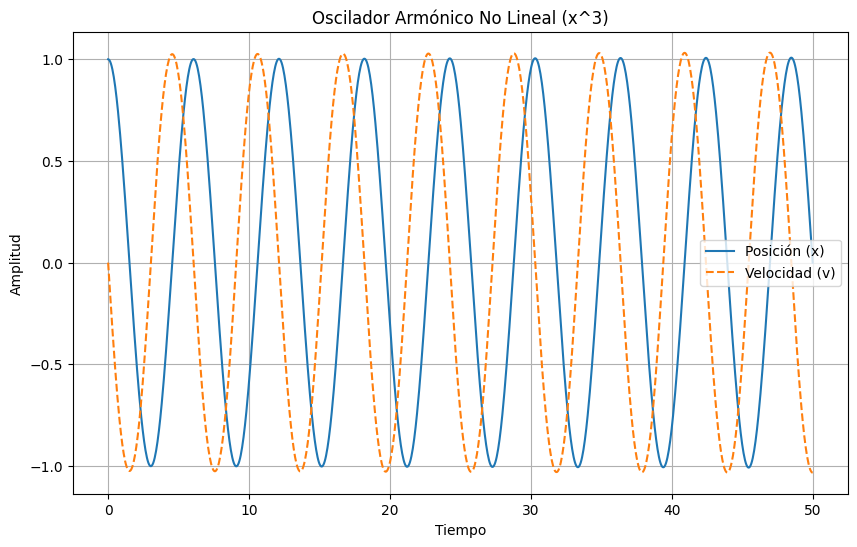

In [ ]:
# Definamos los parámetros del sistema
m = 1.0      # masa
beta = 1.0   # coeficiente del término lineal (resorte)
alpha = 0.1   # coeficiente del término no lineal cúbico

# Definimos el sistema de ecuaciones diferenciales
def osciladorx3(t, y):
    x, v = y
    dxdt = v
    dvdt = -(beta/m) * x - (alpha/m) * x**3
    return [dxdt, dvdt]

# Condiciones iniciales
x0 = 1.0  # posición inicial
v0 = 0.0  # velocidad inicial
y0 = [x0, v0]

# Intervalo de tiempo para la simulación
t_span = (0, 50)
t_eval = np.linspace(0, 50, 1000)  # puntos donde se evaluará la solución

# Resolver la EDO usando solve_ivp
#solve_ivp se usa para resolver el sistema en un tiempo definido
sol = solve_ivp(osciladorx3, t_span, y0, t_eval=t_eval, method='RK45')

# Graficamos los resultados
plt.figure(figsize=(10, 6))
plt.plot(sol.t, sol.y[0], label='Posición (x)')
plt.plot(sol.t, sol.y[1], label='Velocidad (v)', linestyle='dashed')
plt.title('Oscilador Armónico No Lineal (x^3)')
plt.xlabel('Tiempo')
plt.ylabel('Amplitud')
plt.legend()
plt.grid(True)
plt.show()


Al ir modificando los parámetros, hemos encontrado la siguiente interpretación:

Si $ α>O $. El sistema tiene una rigidez "mayor" a medida que el desplazamiento crece (oscila más rápidamente a grandes desplazamientos). Esto se denomina oscilador duro.

Si $α< 0$.El sistema se vuelve más suave con grandes desplazamientos, lo que lleva a un oscilador blando.

Lo mismo notamos para β, al intentar modificar $m>0$, las gráficas mostraban dos funciones constantes, mientras que al cambiar $m< 0$, el código tardaba en ejecutarse.

Este tipo de sistema es más complejo que el oscilador armónico lineal, ya que la presencia del término cúbico genera oscilaciones que no son perfectamente sinusoidales. Dependiendo de los valores de α y β, el sistema puede exhibir fenómenos no lineales como bifurcaciones o incluso caos.

Usando el código adjuntado, tomaremos 10 valores k de entre 0 y 1 Usaremos 3 valores para el tamaño de la partición y 3 para para el número de segmentos. Finalmente, modificaremos el intervalo de tiempo de la solución si consideramos que se pueden ver mejor los resultados.

Este código define las ecuaciones diferenciales también de un oscilador armónico:

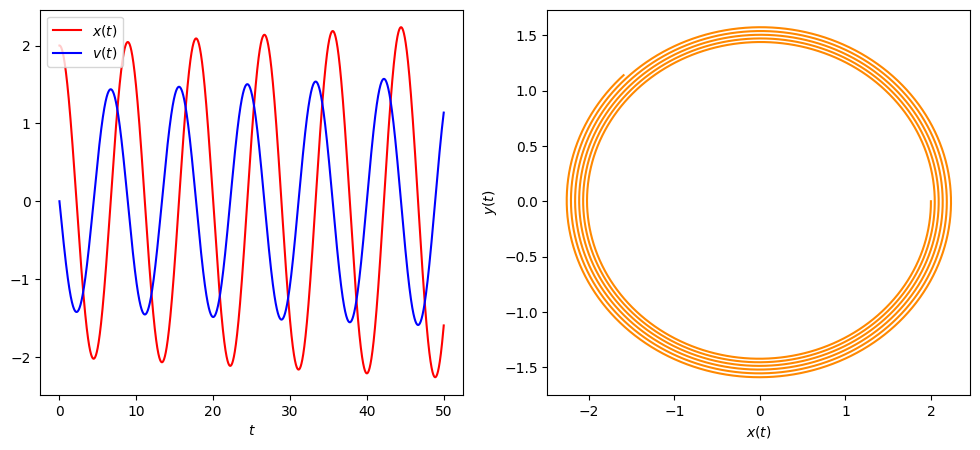

In [46]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

def harmonic_eq(x,t,k):
    # k = 0.5
    return x[1], - k*x[0]

def euler_2var(x, func, t, k, dt):
    y = func(x,t,k)
    return x[0] + dt*y[0], x[1]+ dt*y[1]

def calc_plot2var(method, equation, k, dt, n_steps):
    t = np.arange(0, n_steps*dt, dt)
    x = np.zeros((n_steps,2))               # n_step
    x[0][0] = 2.0                           # initial position
    for i in range(n_steps-1):
        x[i+1] = method(x[i],harmonic_eq, t[i], k, dt)

    fig = plt.figure(figsize=(12,5))
    axes = fig.add_subplot(1,2,1)
    axes.plot(t, x[:,0], 'r', label="$x(t)$")
    axes.plot(t, x[:,1], 'b', label="$v(t)$")
    axes.set_xlabel("$t$")

    plt.legend(loc='upper left')

    #plot a trajectory
    axes = fig.add_subplot(1,2,2)
    axes.plot(x[:,0], x[:,1],'#ff8800')
    axes.set_xlabel("$x(t)$")
    axes.set_ylabel("$y(t)$")
    plt.show()

if __name__ == "__main__" :
    dt = 0.01
    n_steps = 5000
    k = 0.5
    calc_plot2var(euler_2var, harmonic_eq, k, dt, n_steps)

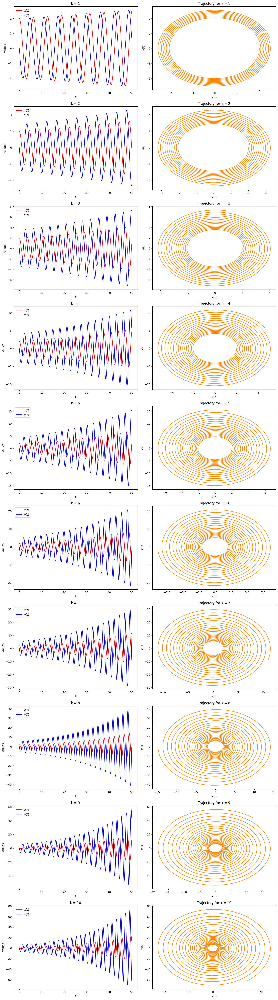

In [47]:
import numpy as np
import matplotlib.pyplot as plt

def harmonic_eq(x, t, k):
    return x[1], -k * x[0]

def euler_2var(x, func, t, k, dt):
    y = func(x, t, k)
    return x[0] + dt * y[0], x[1] + dt * y[1]

def calc_plot2var(method, equation, k_values, dt, n_steps):
    fig, axes = plt.subplots(len(k_values), 2, figsize=(14, 5 * len(k_values)))

    for i, k in enumerate(k_values):
        t = np.arange(0, n_steps * dt, dt)
        x = np.zeros((n_steps, 2))
        x[0][0] = 2.0  # Initial position

        for j in range(n_steps - 1):
            x[j + 1] = method(x[j], equation, t[j], k, dt)

        # Plot x(t) and v(t)
        axes[i, 0].plot(t, x[:, 0], 'r', label="$x(t)$")
        axes[i, 0].plot(t, x[:, 1], 'b', label="$v(t)$")
        axes[i, 0].set_title(f'k = {k}')
        axes[i, 0].set_xlabel("$t$")
        axes[i, 0].set_ylabel("Values")
        axes[i, 0].legend(loc='upper left')

        # Plot trajectory
        axes[i, 1].plot(x[:, 0], x[:, 1], '#ff8800')
        axes[i, 1].set_xlabel("$x(t)$")
        axes[i, 1].set_ylabel("$v(t)$")
        axes[i, 1].set_title(f'Trajectory for k = {k}')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    dt = 0.01
    n_steps = 5000
    k_values = np.arange(1, 11)  # Values of k from 1 to 10
    calc_plot2var(euler_2var, harmonic_eq, k_values, dt, n_steps)


Para modificar el código y realizar las simulaciones con diferentes rangos de valores para k y diferentes tamaños de partición y número de segmentos, podemos definir los rangos de k para usar tres rangos diferentes, probar diferentes tamaños de partición (dt) y número de segmentos n, y finalmente para que se vean mejor, ajustar el intervalo de tiempo para cada combinación.

Usaremos calc_plot2var para aceptar y graficar diferentes valores de k, y para mostrar títulos descriptivos basados en el tamaño de partición y el número de pasos.

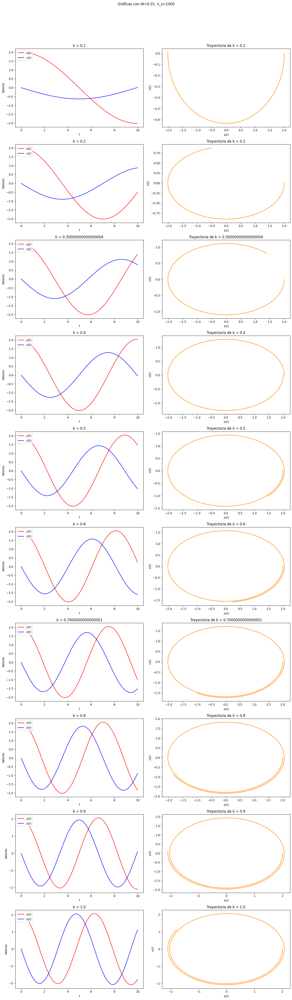

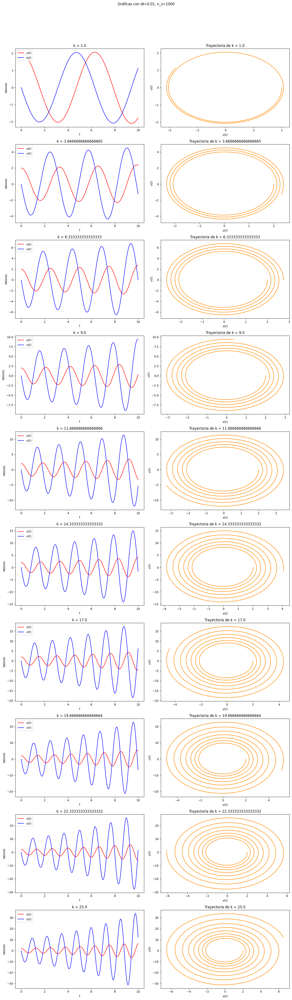

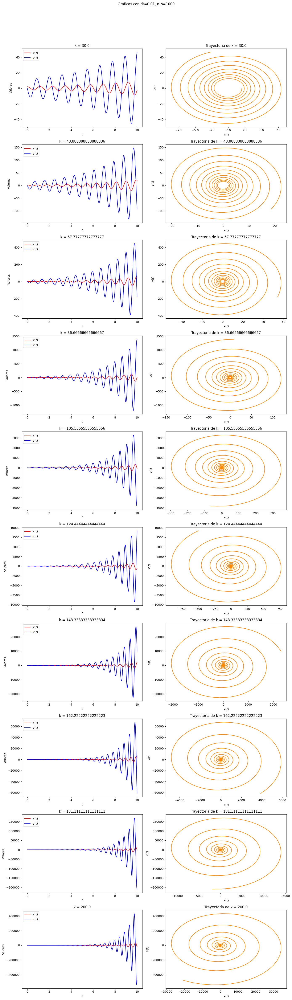

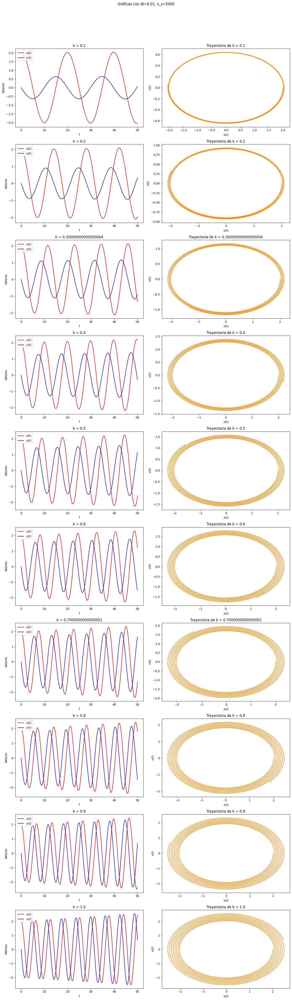

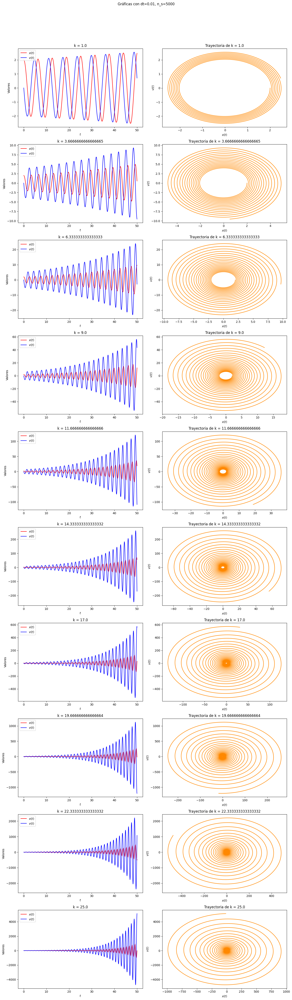

...

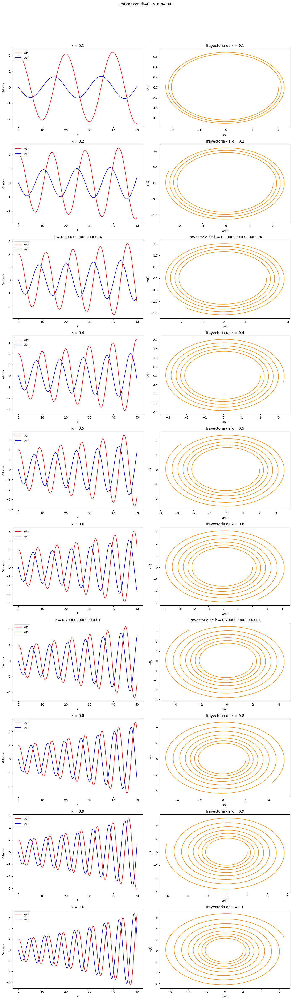

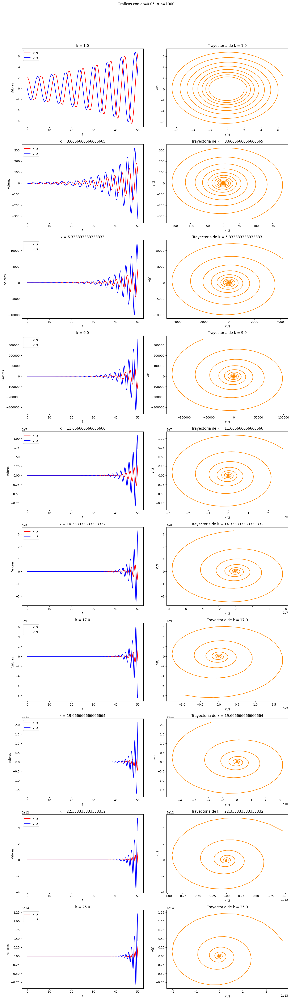

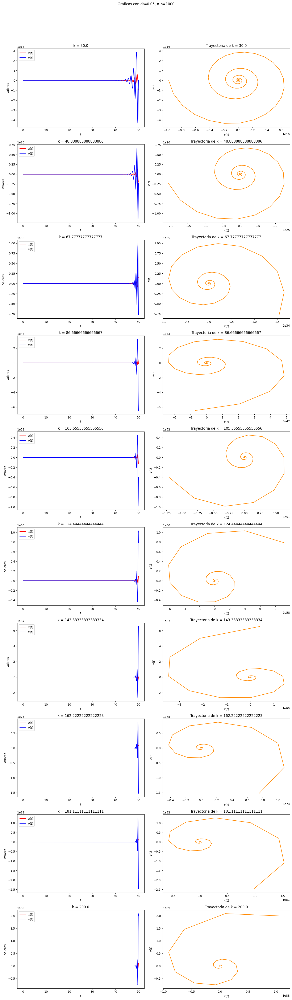

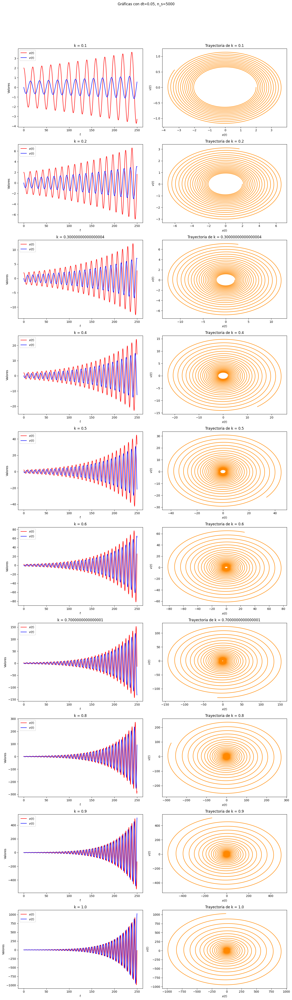

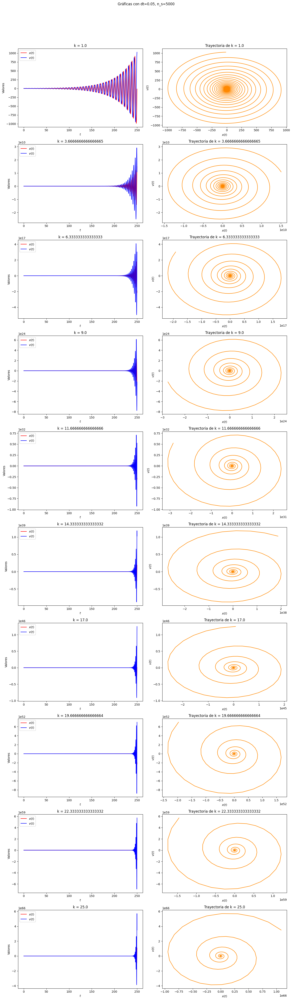

<ipython-input-5-0b3dc35b641f>:5: RuntimeWarning: overflow encountered in scalar multiply
  return x[1], -k * x[0]
<ipython-input-5-0b3dc35b641f>:9: RuntimeWarning: invalid value encountered in scalar add
  return x[0] + dt * y[0], x[1] + dt * y[1]


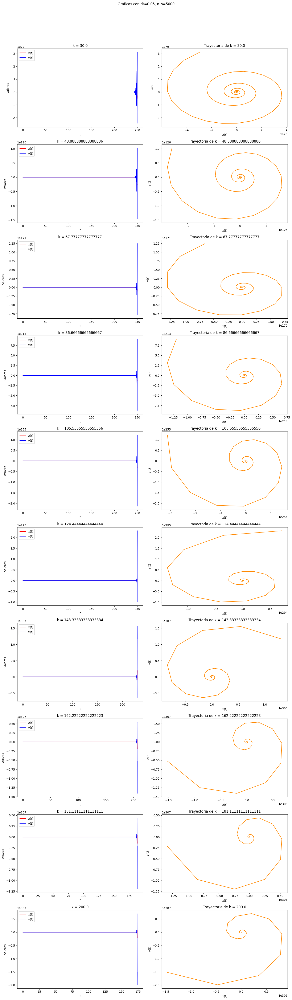

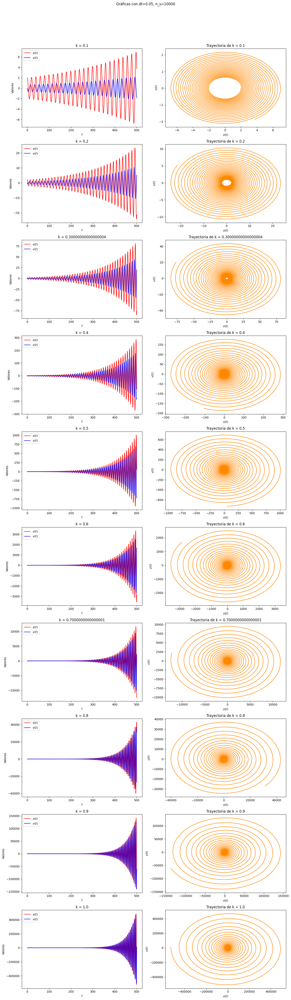

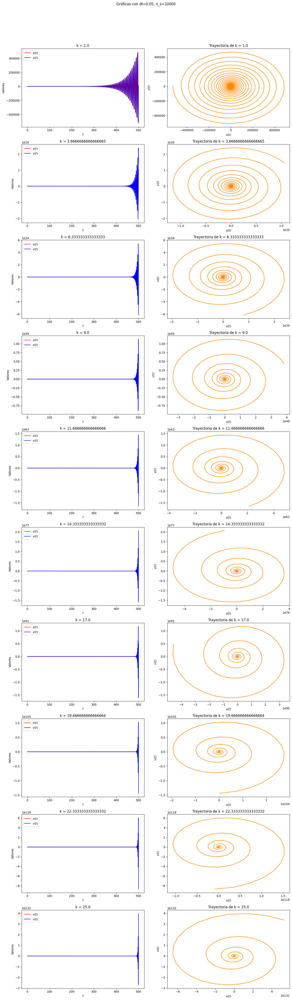

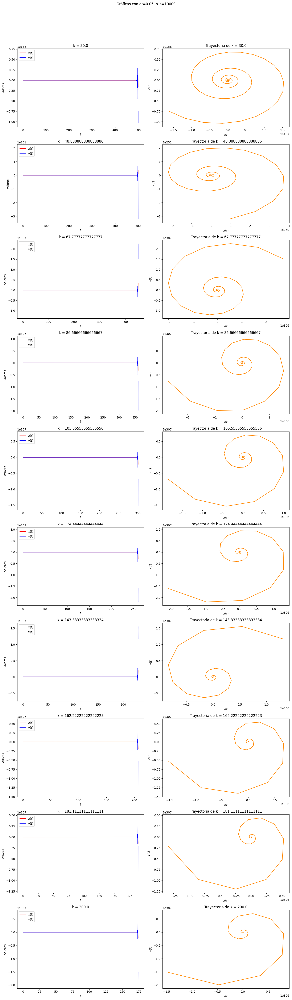

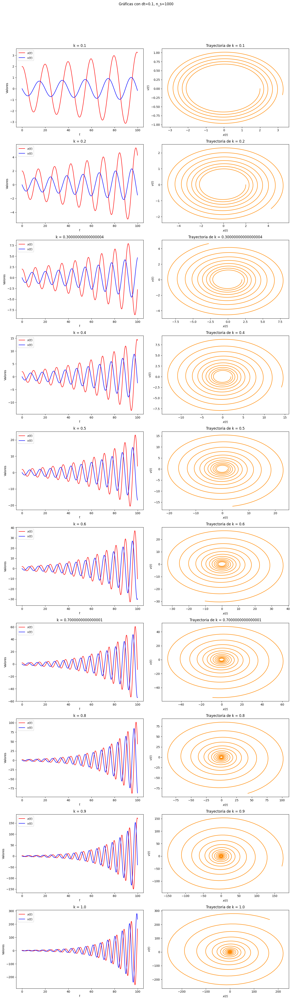

...

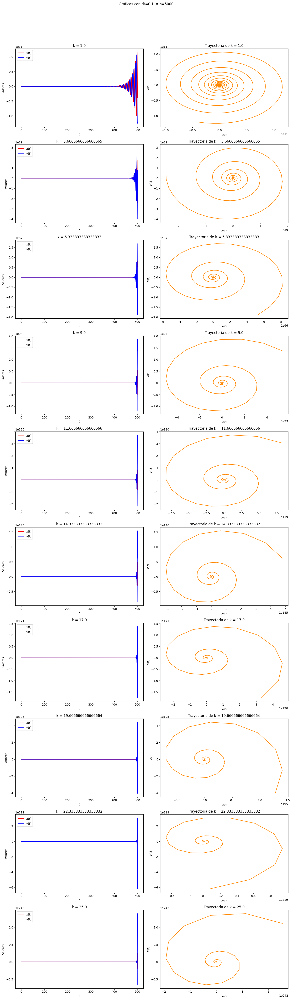

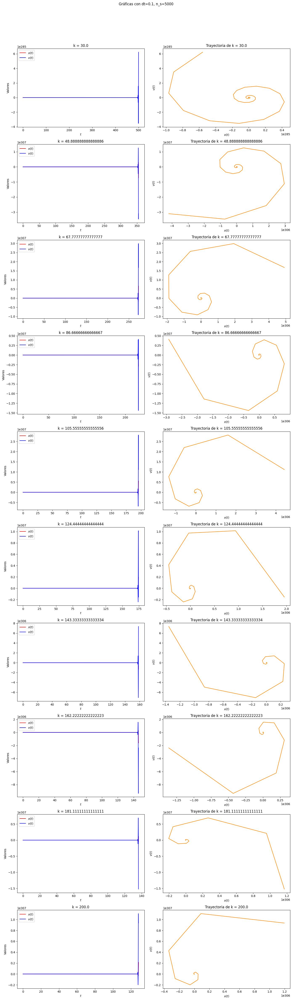

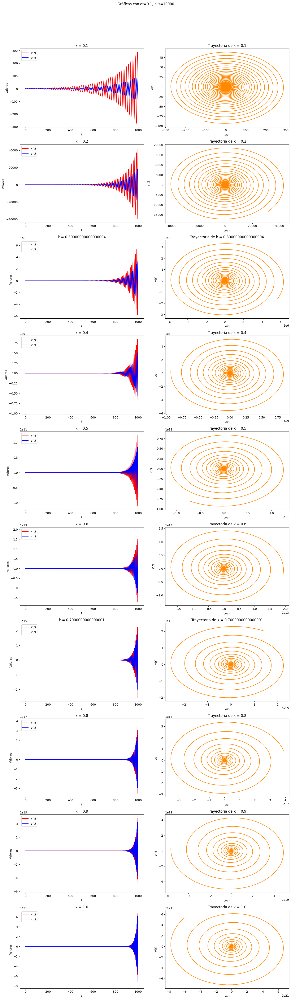

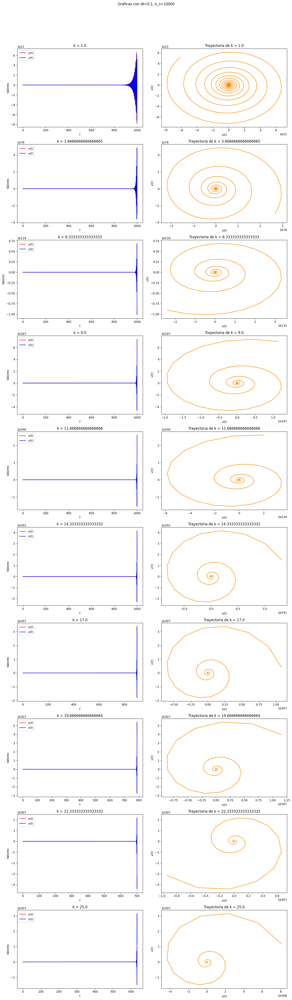

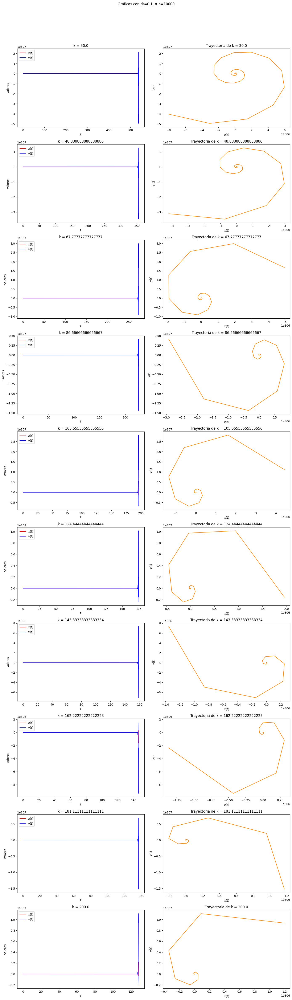

In [5]:
import numpy as np
import matplotlib.pyplot as plt

def ecuacionarmonica(x, t, k):
    return x[1], -k * x[0]

def euler_2var(x, func, t, k, dt):
    y = func(x, t, k)
    return x[0] + dt * y[0], x[1] + dt * y[1]

def calc_plot2var(metodo, ecuacion, k_valores, dt, n_s, t_s =''):
    fig, axes = plt.subplots(len(k_valores), 2, figsize=(14, 5 * len(k_valores)))
    t = np.arange(0, n_s * dt, dt)

    for i, k in enumerate(k_valores):
        x = np.zeros((n_s, 2))
        x[0][0] = 2.0  # Posición inicial

        for j in range(n_s - 1):
            x[j + 1] = metodo(x[j], ecuacion, t[j], k, dt)

        # Gráfica x(t) y v(t)
        axes[i, 0].plot(t, x[:, 0], 'r', label="$x(t)$")
        axes[i, 0].plot(t, x[:, 1], 'b', label="$v(t)$")
        axes[i, 0].set_title(f'k = {k}')
        axes[i, 0].set_xlabel("$t$")
        axes[i, 0].set_ylabel("Valores")
        axes[i, 0].legend(loc='upper left')

        # Plot trajectory
        axes[i, 1].plot(x[:, 0], x[:, 1], '#ff8800')
        axes[i, 1].set_xlabel("$x(t)$")
        axes[i, 1].set_ylabel("$v(t)$")
        axes[i, 1].set_title(f'Trayectoria de k = {k}')

    plt.suptitle(f'Gráficas con {t_s}')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

if __name__ == "__main__":
    k_ranges = [
        np.linspace(0.1, 1, 10),      # k de 0.1 a 1
        np.linspace(1, 25, 10),       # k de 1 a 25
        np.linspace(30, 200, 10)      # k de 30 a 200
    ]

    dt_valores = [0.01, 0.05, 0.1]    # Diferentes particiones
    n_s_v = [1000, 5000, 10000]  # Difetentes números de segmentos

    for dt in dt_valores:
        for n_s in n_s_v:
            for k_range in k_ranges:
                calc_plot2var(euler_2var, ecuacionarmonica, k_range, dt, n_s, t_s=f'dt={dt}, n_s={n_s}')


El código a propósito ejecuta simulaciones para cada combinación de dt, n_particiones, y los diferentes rangos de k, y genera gráficos para cada combinación. Esto nos permite ver cómo cambian los resultados con diferentes configuraciones de parámetros.

Hemos de notar en cada gráfica que mientras mayor sea el número de segmentos n_s, las visibilidad y comportamiento de nuestra gráfica mejora, sin embargo, llega un extremo donde k es tan grande que deja de ser práctico.

*Para valores pequeños de k (de 0 a 1)*

Gráficas de x(t) y v(t): sus oscilaciones suelen ser más suaves y menos pronunciadas. El sistema tiene un movimiento oscilatorio más regular y con menos amortiguamiento.

Diagrama de Fase: Las trayectorias parecen elípticas y menos distorsionadas. Las órbitas son más grandes y menos aplastadas.

*Para valores medianos de k (1 a 25)*

Gráficas de x(t) y v(t): oscilaciones más pronunciadas y más visibles en la gráfica. Tenemos comportamiento de oscilación más definido.

Diagrama de Fase: Las trayectorias se cierran más, y el sistema muestra una compresión en la dirección de las oscilaciones.

*Para valores grandes de k (30 a 200)*

Gráficas de x(t) y v(t): las oscilaciones tienden a ser más rápidas y de menor amplitud. El sistema puede mostrar un comportamiento más amortiguado y menos oscilatorio.

Diagrama de Fase: Las trayectorias en el diagrama de fase se pueden volver más comprimidas y menos elípticas, y el sistema muestra un patrón de espiral hacia el origen.

Si el tamaño de la partición dt es pequeño, las gráficas son más detalladas y precisas, más suaves y menos ruidosas; mientras que si dt es grande, muestran un comportamiento irregular y pueden tener errores numéricos.